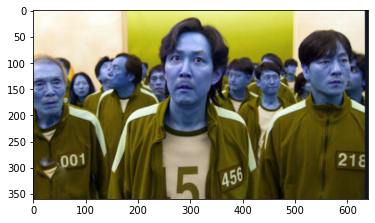

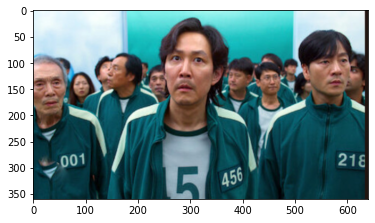

rectangles[[(434, 113) (477, 156)], [(73, 130) (109, 166)], [(235, 68) (342, 175)], [(221, 122) (257, 158)], [(-20, 121) (63, 196)], [(536, 80) (610, 155)], [(365, 114) (401, 150)]]


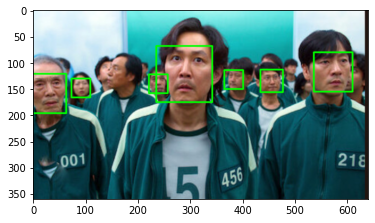

68


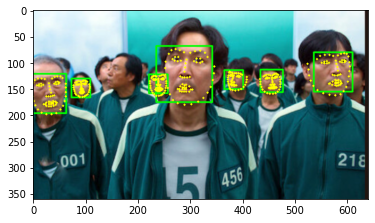

In [1]:
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as img
import numpy as np
import os
import dlib
import copy
import math
import face_recognition


my_image_path = os.getenv('HOME')+'/aiffel/camera_sticker/images/group4.png'
img_bgr = cv2.imread(my_image_path)    #- OpenCV로 이미지를 읽어서
img_bgr = cv2.resize(img_bgr, (640, 360))    # 640x360의 크기로 Resize
img_show = img_bgr.copy()      #- 출력용 이미지 별도 보관
img_bgr2 = img_bgr.copy()
plt.imshow(img_bgr)
plt.show()

# plt.imshow 이전에 RGB 이미지로 바꾸는 것을 잊지마세요. 
img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
plt.imshow(img_rgb)
plt.show()

detector_hog = dlib.get_frontal_face_detector()   #- detector 선언

dlib_rects = detector_hog(img_rgb, 1)   #- (image, num of img pyramid)

print(dlib_rects)   # 찾은 얼굴영역 좌표

for dlib_rect in dlib_rects:
    l = dlib_rect.left()
    t = dlib_rect.top()
    r = dlib_rect.right()
    b = dlib_rect.bottom()

    cv2.rectangle(img_show, (l,t), (r,b), (0,255,0), 2, lineType=cv2.LINE_AA)

img_show_rgb =  cv2.cvtColor(img_show, cv2.COLOR_BGR2RGB)
plt.imshow(img_show_rgb)
plt.show()

model_path = os.getenv('HOME')+'/aiffel/camera_sticker/models/shape_predictor_68_face_landmarks.dat'
landmark_predictor = dlib.shape_predictor(model_path)

list_landmarks = []
for dlib_rect in dlib_rects:
    points = landmark_predictor(img_rgb, dlib_rect)
    list_points = list(map(lambda p: (p.x, p.y), points.parts()))
    list_landmarks.append(list_points)
    
print(len(list_landmarks[0]))

for landmark in list_landmarks:
    for point in landmark:
        cv2.circle(img_show, point, 2, (0, 255, 255), -1) # yellow

img_show_rgb = cv2.cvtColor(img_show, cv2.COLOR_BGR2RGB)
plt.imshow(img_show_rgb)
plt.show()

이미지에서 얼굴을 인식하여 사각형의 영역을 표시
인식한 사각형의 영역을 이용하여 face landmark 표시

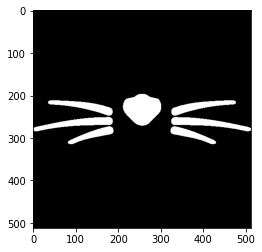

In [2]:
sticker_path = os.getenv('HOME')+'/aiffel/camera_sticker/images/cat.png'
img_sticker = cv2.imread(sticker_path)
img_sticker = cv2.bitwise_not(img_sticker)
plt.imshow(img_sticker)
plt.show()

In [3]:
image = img.imread(sticker_path)
image[250][250]

array([0., 0., 0., 1.], dtype=float32)

합성할 스티커 이미지
king.png 와 hero.png는 배경이 검은색 투명으로 되어있음
cat.png 는 배경이 흰색 투명으로 되어있음
이 차이로 인해 EXPLORATION과 FUNDAMENTAL에서 np.where 사용시 0 값과 255 값을 다르게 넣어줘야 함

cat.png bitwise_not는 회전 시 배경이 검게 나타나 np.where로 배경정보를 빼기위해서 이용

In [4]:
def rotate_image(image, angle):
    # grab the dimensions of the image and then determine the
    # centre
    (h, w) = image.shape[:2]
    (cX, cY) = (w // 2, h // 2)

    # grab the rotation matrix (applying the negative of the
    # angle to rotate clockwise), then grab the sine and cosine
    # (i.e., the rotation components of the matrix)
    M = cv2.getRotationMatrix2D((cX, cY), angle, 1.0)
    cos = np.abs(M[0, 0])
    sin = np.abs(M[0, 1])

    # compute the new bounding dimensions of the image
    nW = int((h * sin) + (w * cos))
    nH = int((h * cos) + (w * sin))

    # adjust the rotation matrix to take into account translation
    M[0, 2] += (nW / 2) - cX
    M[1, 2] += (nH / 2) - cY

    # perform the actual rotation and return the image
    return cv2.warpAffine(image, M, (nW, nH))

landmark = copy.deepcopy(list_landmarks)
for i in range(len(list_landmarks)):
    
    angle=math.degrees(math.atan2(landmark[i][30][0] - landmark[i][27][0],landmark[i][30][1] - landmark[i][27][1]))
   
    if landmark[i][2][0] < 0:
        landmark[i][2] = 0,landmark[i][2][1]
        
    x1 = landmark[i][30][0] - landmark[i][2][0]
    y1 = landmark[i][48][1] - landmark[i][36][1]
    x2 = landmark[i][14][0] - landmark[i][30][0]
    y2 = landmark[i][54][1] - landmark[i][45][1]
    i1=img_sticker[:,:int(len(img_sticker[0])/2),:]
    i2=img_sticker[:,int(len(img_sticker[0])/2):,:]      
    
        
    i1 = cv2.resize(i1, (x1,y1))
    i1 = rotate_image(i1, angle)
    i1 = cv2.resize(i1, (x1,y1))
    i1 = cv2.bitwise_not(i1) 
    i2 = cv2.resize(i2, (x2,y2))   
    i2 = rotate_image(i2, angle)
    i2 = cv2.resize(i2, (x2,y2))
    i2 = cv2.bitwise_not(i2) 
    
    sticker_area1 = img_show[landmark[i][36][1]:landmark[i][36][1]+i1.shape[0], landmark[i][30][0]-i1.shape[1]:landmark[i][30][0]]
    img_show[landmark[i][36][1]:landmark[i][36][1]+i1.shape[0], landmark[i][30][0]-i1.shape[1]:landmark[i][30][0]] = \
        np.where(i1==255,sticker_area1,i1).astype(np.uint8)
    sticker_area2 = img_show[landmark[i][45][1]:landmark[i][45][1]+i2.shape[0], landmark[i][30][0]:landmark[i][30][0]+i2.shape[1]]
    img_show[landmark[i][45][1]:landmark[i][45][1]+i2.shape[0], landmark[i][30][0]:landmark[i][30][0]+i2.shape[1]] = \
        np.where(i2==255,sticker_area2,i2).astype(np.uint8)
    sticker_area1 = img_bgr[landmark[i][36][1]:landmark[i][36][1]+i1.shape[0], landmark[i][30][0]-i1.shape[1]:landmark[i][30][0]]
    img_bgr[landmark[i][36][1]:landmark[i][36][1]+i1.shape[0], landmark[i][30][0]-i1.shape[1]:landmark[i][30][0]] = \
        np.where(i1==255,sticker_area1,i1).astype(np.uint8)
    sticker_area2 = img_bgr[landmark[i][45][1]:landmark[i][45][1]+i2.shape[0], landmark[i][30][0]:landmark[i][30][0]+i2.shape[1]]
    img_bgr[landmark[i][45][1]:landmark[i][45][1]+i2.shape[0], landmark[i][30][0]:landmark[i][30][0]+i2.shape[1]] = \
        np.where(i2==255,sticker_area2,i2).astype(np.uint8)

In [5]:
landmark = copy.deepcopy(list_landmarks)
for i in range(len(list_landmarks)):#이미지에 사각형이 여러개 있을 때 모두 스티커 합성을 수행하기 위해 반복문 이용
    
    angle=math.degrees(math.atan2(landmark[i][30][0] - landmark[i][27][0],landmark[i][30][1] - landmark[i][27][1]))
    #print(math.sin(angle))
   
    if landmark[i][2][0] < 0:
        landmark[i][2] = 0,landmark[i][2][1]
        
    x1 = landmark[i][30][0] - landmark[i][2][0]
    y1 = landmark[i][48][1] - landmark[i][36][1]
    x2 = landmark[i][14][0] - landmark[i][30][0]
    y2 = landmark[i][54][1] - landmark[i][45][1]
    i1=img_sticker[:,:int(len(img_sticker[0])/2),:]
    i2=img_sticker[:,int(len(img_sticker[0])/2):,:]      
    
    c1=int(math.sqrt((x1+y1)/2)*math.sin(angle))
    c2=int(math.sqrt((x2+y2)/2)*math.sin(angle))
    i1 = cv2.resize(i1, (x1,y1))
    i1 = rotate_image(i1, angle)
    i1 = cv2.resize(i1, (x1,y1))
    i1 = cv2.bitwise_not(i1) 
    i2 = cv2.resize(i2, (x2,y2))   
    i2 = rotate_image(i2, angle)
    i2 = cv2.resize(i2, (x2,y2))
    i2 = cv2.bitwise_not(i2) 
    a1=math.floor(i1.shape[0]/2)
    a2=math.ceil(i1.shape[0]/2)
    b1=math.floor(i2.shape[0]/2)
    b2=math.ceil(i2.shape[0]/2)
    
    sticker_area1 = img_show[landmark[i][30][1]-a1-c1:landmark[i][30][1]+a2-c1, landmark[i][30][0]-i1.shape[1]+abs(c1):landmark[i][30][0]+abs(c1)]
    img_show[landmark[i][30][1]-a1-c1:landmark[i][30][1]+a2-c1, landmark[i][30][0]-i1.shape[1]+abs(c1):landmark[i][30][0]+abs(c1)] = \
        np.where(i1==255,sticker_area1,i1).astype(np.uint8)
    sticker_area2 = img_show[landmark[i][30][1]-b1+c2:landmark[i][30][1]+b2+c2, landmark[i][30][0]-abs(c2):landmark[i][30][0]+i2.shape[1]-abs(c2)]
    img_show[landmark[i][30][1]-b1+c2:landmark[i][30][1]+b2+c2, landmark[i][30][0]-abs(c2):landmark[i][30][0]+i2.shape[1]-abs(c2)] = \
        np.where(i2==255,sticker_area2,i2).astype(np.uint8)
    sticker_area1 = img_bgr[landmark[i][30][1]-a1-c1:landmark[i][30][1]+a2-c1, landmark[i][30][0]-i1.shape[1]+abs(c1):landmark[i][30][0]+abs(c1)]
    img_bgr[landmark[i][30][1]-a1-c1:landmark[i][30][1]+a2-c1, landmark[i][30][0]-i1.shape[1]+abs(c1):landmark[i][30][0]+abs(c1)] = \
        np.where(i1==255,sticker_area1,i1).astype(np.uint8)
    sticker_area2 = img_bgr[landmark[i][30][1]-b1+c2:landmark[i][30][1]+b2+c2, landmark[i][30][0]-abs(c2):landmark[i][30][0]+i2.shape[1]-abs(c2)]
    img_bgr[landmark[i][30][1]-b1+c2:landmark[i][30][1]+b2+c2, landmark[i][30][0]-abs(c2):landmark[i][30][0]+i2.shape[1]-abs(c2)] = \
        np.where(i2==255,sticker_area2,i2).astype(np.uint8)

스티커 resize, rotate, 합성할 위치 처리 후 이미지 합성
rotate 후 합성할 위치 조정은 더 좋은 방법을 찾아봐야 할 것 같음

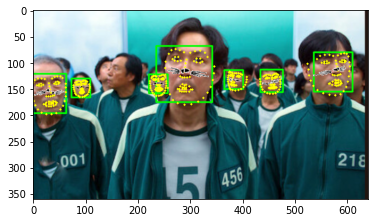

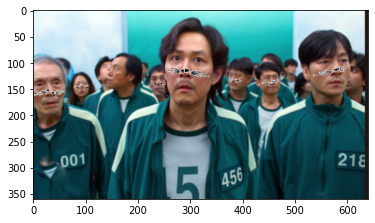

In [6]:
plt.imshow(cv2.cvtColor(img_show, cv2.COLOR_BGR2RGB))
plt.show()
plt.imshow(cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB))
plt.show()

cat.png 이미지를 반으로 잘라 얼굴의 왼편과 오른편의 면적에 맞춰 리사이즈 후 회전된 이미지를 사용하다 보니 위치와 중간부분이 자연스럽지 못하게 나타났다.

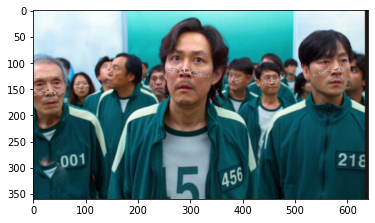

In [7]:
dst = cv2.addWeighted(img_bgr2, 0.5, img_bgr, 0.5, 0)
plt.imshow(cv2.cvtColor(dst, cv2.COLOR_BGR2RGB))
plt.show()

스티커가 반투명하게 addWeighted함수로 이미지 두장 합성

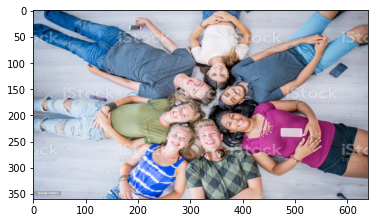

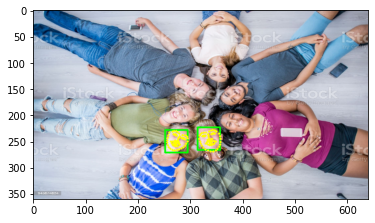

In [8]:
my_image_path = os.getenv('HOME')+'/aiffel/camera_sticker/images/group.png'
img_bgr = cv2.imread(my_image_path)    #- OpenCV로 이미지를 읽어서
img_bgr = cv2.resize(img_bgr, (640, 360))    # 640x360의 크기로 Resize
img_show = img_bgr.copy()      #- 출력용 이미지 별도 보관
img_bgr2 = img_bgr.copy()

# plt.imshow 이전에 RGB 이미지로 바꾸는 것을 잊지마세요. 
img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
plt.imshow(img_rgb)
plt.show()

detector_hog = dlib.get_frontal_face_detector()   #- detector 선언

dlib_rects = detector_hog(img_rgb, 1)   #- (image, num of img pyramid)

for dlib_rect in dlib_rects:
    l = dlib_rect.left()
    t = dlib_rect.top()
    r = dlib_rect.right()
    b = dlib_rect.bottom()

    cv2.rectangle(img_show, (l,t), (r,b), (0,255,0), 2, lineType=cv2.LINE_AA)

img_show_rgb =  cv2.cvtColor(img_show, cv2.COLOR_BGR2RGB)

landmark_predictor = dlib.shape_predictor(model_path)

list_landmarks = []
for dlib_rect in dlib_rects:
    points = landmark_predictor(img_rgb, dlib_rect)
    list_points = list(map(lambda p: (p.x, p.y), points.parts()))
    list_landmarks.append(list_points)


for landmark in list_landmarks:
    for point in landmark:
        cv2.circle(img_show, point, 2, (0, 255, 255), -1) # yellow

img_show_rgb = cv2.cvtColor(img_show, cv2.COLOR_BGR2RGB)
plt.imshow(img_show_rgb)
plt.show()

[(428, 577, 503, 502), (440, 474, 502, 411)]


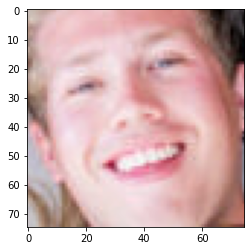

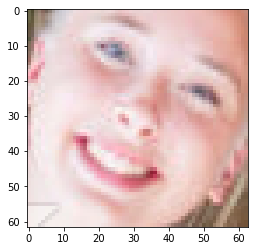

In [9]:
my_image_path = os.getenv('HOME')+'/aiffel/camera_sticker/images/group.png'
image = face_recognition.load_image_file(my_image_path)
face_locations = face_recognition.face_locations(image)

print(face_locations)  # 이미지에서 얼굴 영역의 좌표를 출력합니다.
for i in range(len(face_locations)):
    a, b, c, d = face_locations[i]
    cropped_face = image[a:c,d:b,:]
    plt.imshow(cropped_face)   # 이미지에서 얼굴영역만 잘라낸 cropped_face를 그려 봅니다.
    plt.show()

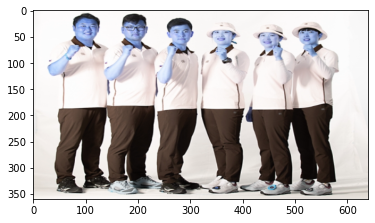

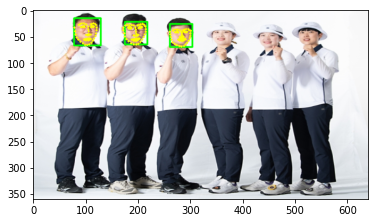

In [10]:
my_image_path = os.getenv('HOME')+'/aiffel/camera_sticker/images/group2.png'
img_bgr = cv2.imread(my_image_path)    #- OpenCV로 이미지를 읽어서
img_bgr = cv2.resize(img_bgr, (640, 360))    # 640x360의 크기로 Resize
img_show = img_bgr.copy()      #- 출력용 이미지 별도 보관
img_bgr2 = img_bgr.copy()
plt.imshow(img_bgr)
plt.show()

# plt.imshow 이전에 RGB 이미지로 바꾸는 것을 잊지마세요. 
img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

detector_hog = dlib.get_frontal_face_detector()   #- detector 선언

dlib_rects = detector_hog(img_rgb, 1)   #- (image, num of img pyramid)

for dlib_rect in dlib_rects:
    l = dlib_rect.left()
    t = dlib_rect.top()
    r = dlib_rect.right()
    b = dlib_rect.bottom()

    cv2.rectangle(img_show, (l,t), (r,b), (0,255,0), 2, lineType=cv2.LINE_AA)

img_show_rgb =  cv2.cvtColor(img_show, cv2.COLOR_BGR2RGB)

landmark_predictor = dlib.shape_predictor(model_path)

list_landmarks = []
for dlib_rect in dlib_rects:
    points = landmark_predictor(img_rgb, dlib_rect)
    list_points = list(map(lambda p: (p.x, p.y), points.parts()))
    list_landmarks.append(list_points)


for landmark in list_landmarks:
    for point in landmark:
        cv2.circle(img_show, point, 2, (0, 255, 255), -1) # yellow

img_show_rgb = cv2.cvtColor(img_show, cv2.COLOR_BGR2RGB)
plt.imshow(img_show_rgb)
plt.show()

[(42, 281, 78, 245), (26, 117, 70, 74), (46, 509, 82, 473), (50, 437, 86, 401), (46, 353, 82, 317), (31, 204, 74, 160)]


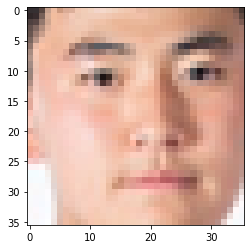

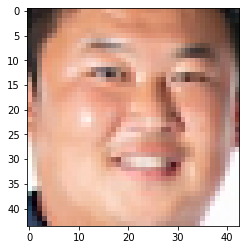

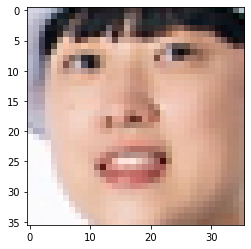

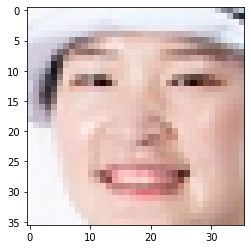

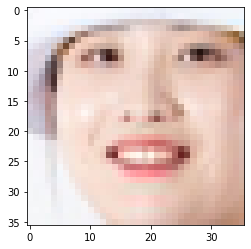

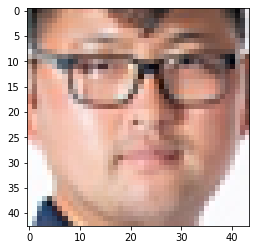

In [11]:
my_image_path = os.getenv('HOME')+'/aiffel/camera_sticker/images/group2.png'
image = face_recognition.load_image_file(my_image_path)
face_locations = face_recognition.face_locations(image)

print(face_locations)  # 이미지에서 얼굴 영역의 좌표를 출력합니다.
for i in range(len(face_locations)):
    a, b, c, d = face_locations[i]
    cropped_face = image[a:c,d:b,:]
    plt.imshow(cropped_face)   # 이미지에서 얼굴영역만 잘라낸 cropped_face를 그려 봅니다.
    plt.show()

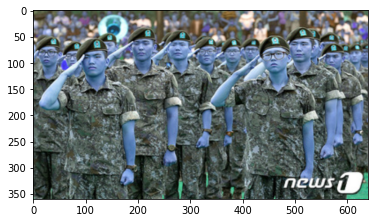

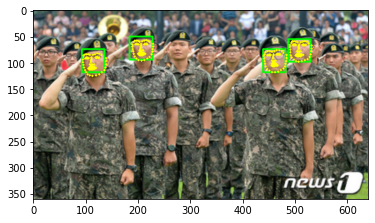

In [12]:
my_image_path = os.getenv('HOME')+'/aiffel/camera_sticker/images/group3.png'
img_bgr = cv2.imread(my_image_path)    #- OpenCV로 이미지를 읽어서
img_bgr = cv2.resize(img_bgr, (640, 360))    # 640x360의 크기로 Resize
img_show = img_bgr.copy()      #- 출력용 이미지 별도 보관
img_bgr2 = img_bgr.copy()
plt.imshow(img_bgr)
plt.show()

# plt.imshow 이전에 RGB 이미지로 바꾸는 것을 잊지마세요. 
img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

detector_hog = dlib.get_frontal_face_detector()   #- detector 선언

dlib_rects = detector_hog(img_rgb, 1)   #- (image, num of img pyramid)

for dlib_rect in dlib_rects:
    l = dlib_rect.left()
    t = dlib_rect.top()
    r = dlib_rect.right()
    b = dlib_rect.bottom()

    cv2.rectangle(img_show, (l,t), (r,b), (0,255,0), 2, lineType=cv2.LINE_AA)

img_show_rgb =  cv2.cvtColor(img_show, cv2.COLOR_BGR2RGB)

landmark_predictor = dlib.shape_predictor(model_path)

list_landmarks = []
for dlib_rect in dlib_rects:
    points = landmark_predictor(img_rgb, dlib_rect)
    list_points = list(map(lambda p: (p.x, p.y), points.parts()))
    list_landmarks.append(list_points)


for landmark in list_landmarks:
    for point in landmark:
        cv2.circle(img_show, point, 2, (0, 255, 255), -1) # yellow

img_show_rgb = cv2.cvtColor(img_show, cv2.COLOR_BGR2RGB)
plt.imshow(img_show_rgb)
plt.show()

In [13]:
my_image_path = os.getenv('HOME')+'/aiffel/camera_sticker/images/group3.png'
image = face_recognition.load_image_file(my_image_path)
face_locations = face_recognition.face_locations(image)

print(face_locations)  # 이미지에서 얼굴 영역의 좌표를 출력합니다.
for i in range(len(face_locations)):
    a, b, c, d = face_locations[i]
    cropped_face = image[a:c,d:b,:]
    plt.imshow(cropped_face)   # 이미지에서 얼굴영역만 잘라낸 cropped_face를 그려 봅니다.
    plt.show()

[]


같은 이미지에서도 dlib.get_frontal_face_detector와 face_recognition.face_locations를 사용했을 때 인식하는 얼굴에 차이가 발생할 수 있음

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:29: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


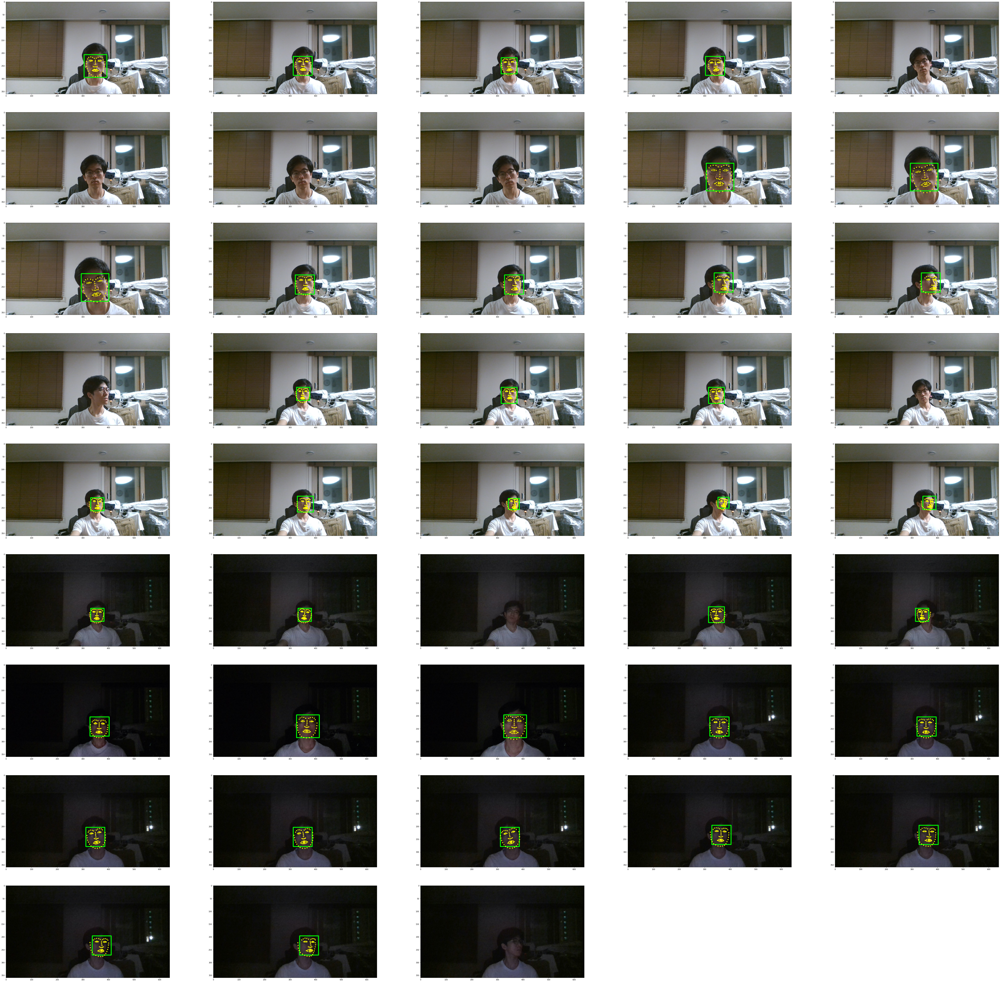

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

<Figure size 1080x1080 with 0 Axes>

In [14]:
fig = plt.figure(figsize=(100, 100))
for i in range(43):
    my_image_path = os.getenv('HOME')+'/aiffel/camera_sticker/images/image'+'{0:0>2}.png'.format(i)
    img_bgr = cv2.imread(my_image_path)    #- OpenCV로 이미지를 읽어서
    img_bgr = cv2.resize(img_bgr, (640, 360))    # 640x360의 크기로 Resize
    img_show = img_bgr.copy()      #- 출력용 이미지 별도 보관
    img_bgr2 = img_bgr.copy()
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    
    dlib_rects = detector_hog(img_rgb, 1)
    for dlib_rect in dlib_rects:
        l = dlib_rect.left()
        t = dlib_rect.top()
        r = dlib_rect.right()
        b = dlib_rect.bottom()
    
        cv2.rectangle(img_show, (l,t), (r,b), (0,255,0), 2, lineType=cv2.LINE_AA)
    
    list_landmarks = []
    for dlib_rect in dlib_rects:
        points = landmark_predictor(img_rgb, dlib_rect)
        list_points = list(map(lambda p: (p.x, p.y), points.parts()))
        list_landmarks.append(list_points)    
        
    for landmark in list_landmarks:
        for point in landmark:
            cv2.circle(img_show, point, 2, (0, 255, 255), -1)    
    img_show_rgb =  cv2.cvtColor(img_show, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(15, 15))    
    im=fig.add_subplot(9, 5, i+1)
    im.imshow(img_show_rgb)
    
    
plt.show()    

밝기, 각도, 거리에 따른 얼굴 인식 차이를 보기위해 위에서 진행한 4장의 이미지와 직접 촬영한 여러장의 사진으로 보아 거리는 눈, 코, 입의 형태를 인식할 수 있을 정도면 되는것 같다. 밝기도 마찬가지로 형태를 인식할 수 있다면 지장없다. 각도는 얼굴이 돌아가거나 기울어진 정도가 심할 경우 인식이 불가능 했다.